In [ ]:

import requests
import pandas as pd

# Define the API endpoint
url = "https://api.pokemontcg.io/v2/sets"

# Send the request to the API
response = requests.get(url)

# Parse the JSON response
sets = response.json()

# Create a list to store the set information
sets_list = []

# Display the available sets
for set in sets['data']:
    sets_list.append({
        "Set Name": set['name'],
        "Set Code": set['id'],
        "Release Date": set['releaseDate']
    })

# Convert the list to a DataFrame
sets_df = pd.DataFrame(sets_list)

# Print the DataFrame
print(sets_df)

                      Set Name Set Code Release Date
0                         Base    base1   1999/01/09
1                       Jungle    base2   1999/06/16
2    Wizards Black Star Promos    basep   1999/07/01
3                       Fossil    base3   1999/10/10
4                   Base Set 2    base4   2000/02/24
..                         ...      ...          ...
155                        151   sv3pt5   2023/09/22
156               Paradox Rift      sv4   2023/11/03
157              Paldean Fates   sv4pt5   2024/01/26
158            Temporal Forces      sv5   2024/03/22
159        Twilight Masquerade      sv6   2024/05/24

[160 rows x 3 columns]


In [ ]:

import requests
import pandas as pd

# Define the deck dictionary
deck = {
    "Hisuian Growlithe": {"set": "LOR", "number": 83, "quantity": 4},
    "Munkidori": {"set": "TWM", "number": 95, "quantity": 3},
    "Hisuian Arcanine": {"set": "TWM", "number": 100, "quantity": 4},
    "Snorunt": {"set": "SIT", "number": 41, "quantity": 3},
    "Froslass": {"set": "TWM", "number": 53, "quantity": 3},
    "Cleffa": {"set": "OBF", "number": 80, "quantity": 1},
    "Counter Catcher": {"set": "PAR", "number": 160, "quantity": 1},
    "Nest Ball": {"set": "PAF", "number": 84, "quantity": 3},
    "Irida": {"set": "ASR", "number": 147, "quantity": 1},
    "Ultra Ball": {"set": "PAF", "number": 91, "quantity": 3},
    "Pokégear 3.0": {"set": "SVI", "number": 186, "quantity": 3},
    "Iscan": {"set": "LOR", "number": 158, "quantity": 4},
    "Artazon": {"set": "PAL", "number": 171, "quantity": 3},
    "Boss's Orders": {"set": "PAL", "number": 172, "quantity": 2},
    "Hyper Aroma": {"set": "TWM", "number": 152, "quantity": 1},
    "Lana's Aid": {"set": "TWM", "number": 155, "quantity": 1},
    "Iono": {"set": "PAL", "number": 185, "quantity": 2},
    "Colress's Experiment": {"set": "LOR", "number": 155, "quantity": 4},
    "Super Rod": {"set": "PAL", "number": 188, "quantity": 1},
    "Buddy-Buddy Poffin": {"set": "TEF", "number": 144, "quantity": 4},
    "Switch": {"set": "SVI", "number": 194, "quantity": 2},
    "Earthen Vessel": {"set": "PAR", "number": 163, "quantity": 2},
    "Basic {D} Energy": {"set": "Energy", "number": 15, "quantity": 5},
}

# Define the API endpoint
api_url = "https://api.pokemontcg.io/v2/cards"

# Create a list to store detailed card information
detailed_deck_list = []

# Traverse the deck dictionary and fetch card details from the API
for card_name, card_info in deck.items():
    # Construct the search query
    query = f"name:\"{card_name}\" number:{card_info['number']}"
    params = {"q": query}

    # Send the request to the API
    response = requests.get(api_url, params=params)
    if response.status_code == 200:
        card_data = response.json()
        if card_data['data']:
            card_details = card_data['data'][0]
            detailed_deck_list.append({
                "Card Name": card_name,
                "Set": card_info['set'],
                "Number": card_info['number'],
                "Quantity": card_info['quantity'],
                "Image URL": card_details['images']['large'],
             "Supertype": card_details['supertype'],
                "HP": card_details.get('hp', 'N/A'),
                "Attacks": [attack['name'] for attack in card_details.get('attacks', [])]
            })

# Convert the list to a DataFrame
detailed_deck_df = pd.DataFrame(detailed_deck_list)

# Print the DataFrame
print(detailed_deck_df)

               Card Name  Set  Number  Quantity  \
0      Hisuian Growlithe  LOR      83         4   
1              Munkidori  TWM      95         3   
2       Hisuian Arcanine  TWM     100         4   
3                Snorunt  SIT      41         3   
4               Froslass  TWM      53         3   
5                 Cleffa  OBF      80         1   
6        Counter Catcher  PAR     160         1   
7              Nest Ball  PAF      84         3   
8                  Irida  ASR     147         1   
9             Ultra Ball  PAF      91         3   
10          Pokégear 3.0  SVI     186         3   
11                 Iscan  LOR     158         4   
12               Artazon  PAL     171         3   
13         Boss's Orders  PAL     172         2   
14           Hyper Aroma  TWM     152         1   
15            Lana's Aid  TWM     155         1   
16                  Iono  PAL     185         2   
17  Colress's Experiment  LOR     155         4   
18             Super Rod  PAL  

In [ ]:
import requests
import pandas as pd
from PIL import Image
from io import BytesIO

# Define the deck dictionary
deck = {
    "Hisuian Growlithe": {"set": "LOR", "number": 83, "quantity": 4},
    "Munkidori": {"set": "TWM", "number": 95, "quantity": 3},
    "Hisuian Arcanine": {"set": "TWM", "number": 100, "quantity": 4},
    "Snorunt": {"set": "SIT", "number": 41, "quantity": 3},
    "Froslass": {"set": "TWM", "number": 53, "quantity": 3},
    "Cleffa": {"set": "OBF", "number": 80, "quantity": 1},
    "Counter Catcher": {"set": "PAR", "number": 160, "quantity": 1},
    "Nest Ball": {"set": "PAF", "number": 84, "quantity": 3},
    "Irida": {"set": "ASR", "number": 147, "quantity": 1},
    "Ultra Ball": {"set": "PAF", "number": 91, "quantity": 3},
    "Pokégear 3.0": {"set": "SVI", "number": 186, "quantity": 3},
    "Iscan": {"set": "LOR", "number": 158, "quantity": 4},
    "Artazon": {"set": "PAL", "number": 171, "quantity": 3},
    "Boss's Orders": {"set": "PAL", "number": 172, "quantity": 2},
    "Hyper Aroma": {"set": "TWM", "number": 152, "quantity": 1},
    "Lana's Aid": {"set": "TWM", "number": 155, "quantity": 1},
    "Iono": {"set": "PAL", "number": 185, "quantity": 2},
    "Colress's Experiment": {"set": "LOR", "number": 155, "quantity": 4},
    "Super Rod": {"set": "PAL", "number": 188, "quantity": 1},
    "Buddy-Buddy Poffin": {"set": "TEF", "number": 144, "quantity": 4},
    "Switch": {"set": "SVI", "number": 194, "quantity": 2},
    "Earthen Vessel": {"set": "PAR", "number": 163, "quantity": 2},
    "Basic {D} Energy": {"set": "Energy", "number": 15, "quantity": 5},
}

# Define the API endpoint
api_url = "https://api.pokemontcg.io/v2/cards"

# Create a list to store the image URLs
image_urls = []

# Traverse the deck dictionary and fetch card details from the API
for card_name, card_info in deck.items():
    # Construct the search query
    query = f"name:\"{card_name}\" number:{card_info['number']}"
    params = {"q": query}

    # Send the request to the API
    response = requests.get(api_url, params=params)
    if response.status_code == 200:
        card_data = response.json()
        if card_data['data']:
            card_details = card_data['data'][0]
            image_urls.append(card_details['images']['large'])

# Function to combine images into a single image
def combine_images(image_urls, images_per_row=10):
    images = [Image.open(BytesIO(requests.get(url).content)) for url in image_urls]
    widths, heights = zip(*(img.size for img in images))
    total_width = sum(widths[:images_per_row])
    max_height = max(heights) * ((len(images) + images_per_row - 1) // images_per_row)

    combined_image = Image.new('RGB', (total_width, max_height))

    x_offset = 0
    y_offset = 0
    for i, img in enumerate(images):
        if i % images_per_row == 0 and i != 0:
            x_offset = 0
            y_offset += max(heights)
        combined_image.paste(img, (x_offset, y_offset))
        x_offset += img.width

    return combined_image

# Combine images into a single image
combined_image = combine_images(image_urls)

# Save or display the combined image
combined_image.save('combined_deck_image.jpg')
combined_image.show()

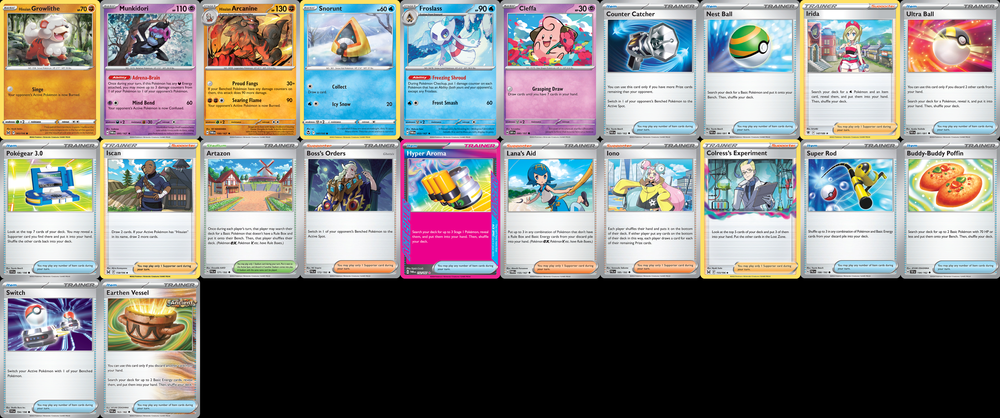

In [ ]:
combined_image

In [ ]:
import requests
import pandas as pd
from PIL import Image, ImageDraw, ImageFont
from io import BytesIO

# Define the deck dictionary
deck = {
    "Hisuian Growlithe": {"set": "LOR", "number": 83, "quantity": 4},
    "Munkidori": {"set": "TWM", "number": 95, "quantity": 3},
    "Hisuian Arcanine": {"set": "TWM", "number": 100, "quantity": 4},
    "Snorunt": {"set": "SIT", "number": 41, "quantity": 3},
    "Froslass": {"set": "TWM", "number": 53, "quantity": 3},
    "Cleffa": {"set": "OBF", "number": 80, "quantity": 1},
    "Counter Catcher": {"set": "PAR", "number": 160, "quantity": 1},
    "Nest Ball": {"set": "PAF", "number": 84, "quantity": 3},
    "Irida": {"set": "ASR", "number": 147, "quantity": 1},
    "Ultra Ball": {"set": "PAF", "number": 91, "quantity": 3},
    "Pokégear 3.0": {"set": "SVI", "number": 186, "quantity": 3},
    "Iscan": {"set": "LOR", "number": 158, "quantity": 4},
    "Artazon": {"set": "PAL", "number": 171, "quantity": 3},
    "Boss's Orders": {"set": "PAL", "number": 172, "quantity": 2},
    "Hyper Aroma": {"set": "TWM", "number": 152, "quantity": 1},
    "Lana's Aid": {"set": "TWM", "number": 155, "quantity": 1},
    "Iono": {"set": "PAL", "number": 185, "quantity": 2},
    "Colress's Experiment": {"set": "LOR", "number": 155, "quantity": 4},
    "Super Rod": {"set": "PAL", "number": 188, "quantity": 1},
    "Buddy-Buddy Poffin": {"set": "TEF", "number": 144, "quantity": 4},
    "Switch": {"set": "SVI", "number": 194, "quantity": 2},
    "Earthen Vessel": {"set": "PAR", "number": 163, "quantity": 2},
    "Basic {D} Energy": {"set": "Energy", "number": 15, "quantity": 5},
}

# Define the API endpoint
api_url = "https://api.pokemontcg.io/v2/cards"

# Create a list to store the image URLs and quantities
card_images_info = []

# Traverse the deck dictionary and fetch card details from the API
for card_name, card_info in deck.items():
    # Construct the search query
    query = f"name:\"{card_name}\" number:{card_info['number']}"
    params = {"q": query}

    # Send the request to the API
    response = requests.get(api_url, params=params)
    if response.status_code == 200:
        card_data = response.json()
        if card_data['data']:
            card_details = card_data['data'][0]
            card_images_info.append({
                "url": card_details['images']['large'],
                "quantity": card_info['quantity']
            })

# Function to combine images into a single image with quantity overlay
def combine_images_with_quantity(card_images_info, images_per_row=7):
    images = [Image.open(BytesIO(requests.get(info['url']).content)) for info in card_images_info]
    quantities = [info['quantity'] for info in card_images_info]
    widths, heights = zip(*(img.size for img in images))
    total_width = max(widths) * images_per_row
    max_height = max(heights) * ((len(images) + images_per_row - 1) // images_per_row)

    combined_image = Image.new('RGB', (total_width, max_height))

    x_offset = 0
    y_offset = 0
    for i, (img, qty) in enumerate(zip(images, quantities)):
        if i % images_per_row == 0 and i != 0:
            x_offset = 0
            y_offset += max(heights)
        combined_image.paste(img, (x_offset, y_offset))

        # Draw quantity overlay
        draw = ImageDraw.Draw(combined_image)
        font = ImageFont.load_default()
        text = f"x{qty}"
        text_size = draw.textsize(text, font=font)
        text_x = x_offset + 5
        text_y = y_offset + 5
        draw.rectangle([text_x, text_y, text_x + text_size[0], text_y + text_size[1]], fill="black")
        draw.text((text_x, text_y), text, fill="white", font=font)

        x_offset += img.width

    return combined_image

# Combine images into a single image with quantity overlay
combined_image = combine_images_with_quantity(card_images_info)

# Save or display the combined image
combined_image.save('combined_deck_image_with_quantity.jpg')
combined_image

<ipython-input-3-154975a93fce>:78: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text, font=font)
<ipython-input-3-154975a93fce>:78: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text, font=font)
<ipython-input-3-154975a93fce>:78: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text, font=font)
<ipython-input-3-154975a93fce>:78: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = draw.textsize(text, font=font)
<ipython-input-3-154975a93fce>:78: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_size = d

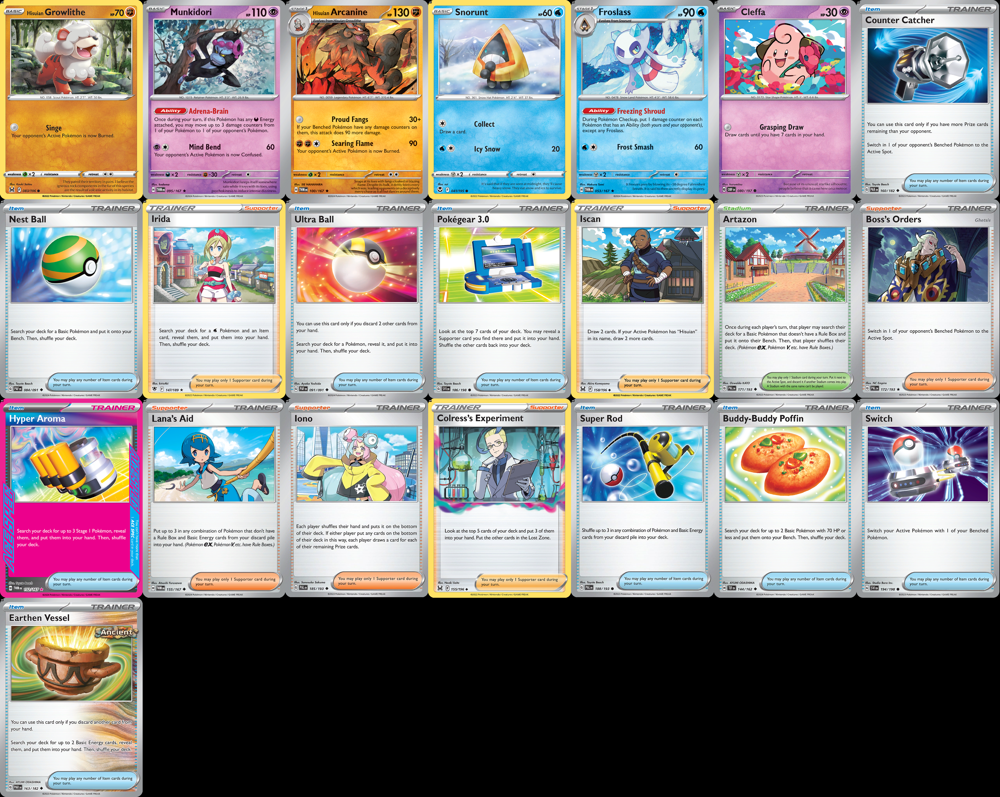

In [ ]:
combined_image

In [ ]:

from scipy.stats import hypergeom
import pandas as pd

# Define the deck dictionary
deck = {
    "Hisuian Growlithe": {"set": "LOR", "number": 83, "quantity": 4},
    "Munkidori": {"set": "TWM", "number": 95, "quantity": 3},
    "Hisuian Arcanine": {"set": "TWM", "number": 100, "quantity": 4},
    "Snorunt": {"set": "SIT", "number": 41, "quantity": 3},
    "Froslass": {"set": "TWM", "number": 53, "quantity": 3},
    "Cleffa": {"set": "OBF", "number": 80, "quantity": 1},
    "Counter Catcher": {"set": "PAR", "number": 160, "quantity": 1},
    "Nest Ball": {"set": "PAF", "number": 84, "quantity": 3},
    "Irida": {"set": "ASR", "number": 147, "quantity": 1},
    "Ultra Ball": {"set": "PAF", "number": 91, "quantity": 3},
    "Pokégear 3.0": {"set": "SVI", "number": 186, "quantity": 3},
    "Iscan": {"set": "LOR", "number": 158, "quantity": 4},
    "Artazon": {"set": "PAL", "number": 171, "quantity": 3},
    "Boss's Orders": {"set": "PAL", "number": 172, "quantity": 2},
    "Hyper Aroma": {"set": "TWM", "number": 152, "quantity": 1},
    "Lana's Aid": {"set": "TWM", "number": 155, "quantity": 1},
    "Iono": {"set": "PAL", "number": 185, "quantity": 2},
    "Colress's Experiment": {"set": "LOR", "number": 155, "quantity": 4},
    "Super Rod": {"set": "PAL", "number": 188, "quantity": 1},
    "Buddy-Buddy Poffin": {"set": "TEF", "number": 144, "quantity": 4},
    "Switch": {"set": "SVI", "number": 194, "quantity": 2},
    "Earthen Vessel": {"set": "PAR", "number": 163, "quantity": 2},
    "Basic {D} Energy": {"set": "Energy", "number": 15, "quantity": 5},
}

# The number of cards left in the deck after setting aside the prize cards
total_cards = 60
prize_cards = 6
cards_left_in_deck = total_cards - prize_cards  # 54 cards
hand_size = 7

# Function to calculate the combined probability considering the prize cards and the first hand drawing
def combined_probability(card_quantity, total_cards, prize_cards, hand_size):
    probabilities = []
    # Calculate the probability for each possible number of copies in the prize cards
    for k in range(0, min(card_quantity, prize_cards) + 1):
        # Probability that k copies are in the prize cards
        prob_k_in_prizes = hypergeom.pmf(k, total_cards, card_quantity, prize_cards)
        # Probability of drawing at least one copy from the remaining card_quantity - k copies
        remaining_copies = card_quantity - k
        if remaining_copies > 0:
            prob_at_least_one = 1 - hypergeom.cdf(0, cards_left_in_deck, remaining_copies, hand_size)
        else:
            prob_at_least_one = 0
        # Combine the probabilities
        combined_prob = prob_k_in_prizes * prob_at_least_one
        probabilities.append(combined_prob)
    # Sum all combined probabilities
    total_probability = sum(probabilities)
    return total_probability

# Calculate the probabilities for each card in the deck
probabilities = [
    {"Card Name": card,
     "Probability": combined_probability(details["quantity"], total_cards, prize_cards, hand_size)}
    for card, details in deck.items()
]

# Convert the list of dictionaries to a DataFrame
probabilities_df = pd.DataFrame(probabilities)

# Print the DataFrame
print(probabilities_df)

               Card Name  Probability
0      Hisuian Growlithe     0.399500
1              Munkidori     0.315430
2       Hisuian Arcanine     0.399500
3                Snorunt     0.315430
4               Froslass     0.315430
5                 Cleffa     0.116667
6        Counter Catcher     0.116667
7              Nest Ball     0.315430
8                  Irida     0.116667
9             Ultra Ball     0.315430
10          Pokégear 3.0     0.315430
11                 Iscan     0.399500
12               Artazon     0.315430
13         Boss's Orders     0.221469
14           Hyper Aroma     0.116667
15            Lana's Aid     0.116667
16                  Iono     0.221469
17  Colress's Experiment     0.399500
18             Super Rod     0.116667
19    Buddy-Buddy Poffin     0.399500
20                Switch     0.221469
21        Earthen Vessel     0.221469
22      Basic {D} Energy     0.474562
